## Try to understand sub-tropics MHT at 2 months -- 10 years in deep ocean

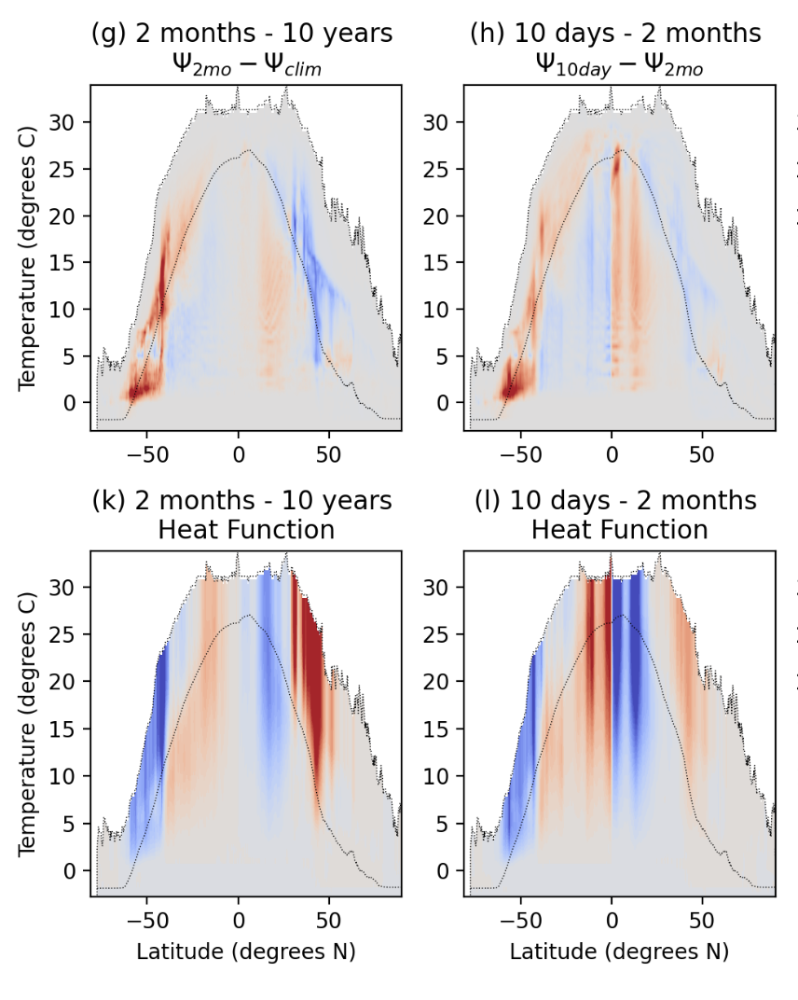

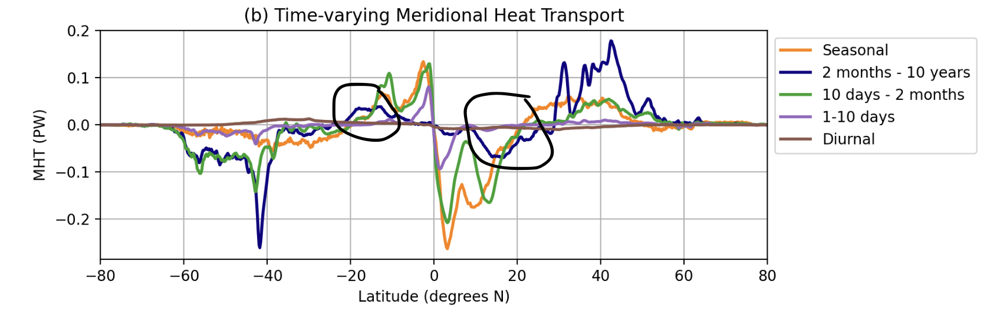

In [1]:
#Load required packages
%matplotlib inline
import matplotlib.pyplot as plt
import xarray as xr
from xgcm import Grid
import numpy as np
import pandas as pd
import cftime
import IPython.display
import cmocean as cm
import cartopy.crs as ccrs
import cartopy.feature as cft
import sys, os
import warnings
warnings.simplefilter("ignore")
from dask.distributed import Client

from xhistogram.xarray import histogram


In [2]:
client = Client(n_workers=8)
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 8
Total threads: 16,Total memory: 250.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:45111,Workers: 8
Dashboard: /proxy/8787/status,Total threads: 16
Started: Just now,Total memory: 250.00 GiB
Comm: tcp://127.0.0.1:41191,Total threads: 2
Dashboard: /proxy/36239/status,Memory: 31.25 GiB
Nanny: tcp://127.0.0.1:39099,


In [3]:
# files:
base = '/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/';
xch = 1440#2*288
ych = 1080#2*216

fgrd   = xr.open_dataset(base + 'output096/ocean/ocean_grid.nc').chunk({'yt_ocean':ych,'yu_ocean':ych,'xt_ocean':xch,'xu_ocean':xch})
fwmass_mean = xr.open_mfdataset('/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/output096-105_mean/ocean_wmass_mean.nc').chunk({'grid_yt_ocean':ych,'grid_yu_ocean':ych,'grid_xt_ocean':xch})
fmonth_mean = xr.open_mfdataset('/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/output096-105_mean/ocean_month_mean.nc').chunk({'yt_ocean':ych,'yu_ocean':ych,'xt_ocean':xch})
fheat_mean = xr.open_mfdataset('/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/output096-105_mean/ocean_heat_mean.nc').chunk({'yt_ocean':ych,'xt_ocean':xch})

fwmass_sc = xr.open_mfdataset('/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/output096-105_mean/ocean_wmass.ncea.nc').chunk({'grid_yt_ocean':ych,'grid_yu_ocean':ych,'grid_xt_ocean':xch})
fmonth_sc = xr.open_mfdataset('/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/output096-105_mean/ocean_month.ncea.nc').chunk({'yt_ocean':ych,'yu_ocean':ych,'xt_ocean':xch})
fheat_sc = xr.open_mfdataset('/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/output096-105_mean/ocean_heat.ncea.nc').chunk({'yt_ocean':ych,'xt_ocean':xch})

# load RYF monthly data
base_msc = '/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/'
# ---------------------------------------------------------------------------------- #
# load in data set ----------------------------------------------------------------- #
fmonth_m = xr.open_mfdataset(base_msc+'output096/ocean/ocean_month.nc',combine='by_coords',chunks={'time': 1},decode_times = True).chunk({'time': 1,'yt_ocean':ych/10,'xt_ocean':xch/10})
fheat_m = xr.open_mfdataset(base_msc+'output096/ocean/ocean_heat.nc',combine='by_coords',chunks={'time': 1},decode_times = True).chunk({'time': 1,'yt_ocean':ych/10,'xt_ocean':xch/10})
fwmass_m = xr.open_mfdataset(base_msc+'output096/ocean/ocean_wmass.nc',combine='by_coords',chunks={'time': 1},decode_times = True).chunk({'time': 1,'grid_yt_ocean':ych/10,'grid_xt_ocean':xch/10})

# load RYF daily data
base_msc = '/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/'
# ---------------------------------------------------------------------------------- #
# load in data set ----------------------------------------------------------------- #
fdaily = xr.open_mfdataset(base_msc+'output096/ocean/ocean_daily.nc',combine='by_coords',chunks={'time': 1},decode_times = True).chunk({'time': 1,'yt_ocean':ych/10,'xt_ocean':xch/10})
fheat_daily = xr.open_mfdataset(base_msc+'output096/ocean/ocean_heat_daily.nc',combine='by_coords',chunks={'time': 1},decode_times = True).chunk({'time': 1,'yt_ocean':ych/10,'xt_ocean':xch/10})
fwmass_daily = xr.open_mfdataset(base_msc+'output096/ocean/ocean_wmass_daily.nc',combine='by_coords',chunks={'time': 1},decode_times = True).chunk({'time': 1,'grid_yt_ocean':ych/10,'grid_xt_ocean':xch/10})

# ---------------------------------------------------------------------------------- #

# Generate xgcm grid object:
gridwm = Grid(fwmass_m,coords={"x":{"center":"grid_xt_ocean"},
                             "y":{"center":"grid_yt_ocean","right":"grid_yu_ocean"},
                             "T":{"center":"neutral","outer":"neutralrho_edges"}},periodic=False)
gridmn = Grid(fmonth_m,coords={"x":{"center":"xt_ocean"},
                             "y":{"center":"yt_ocean","right":"yu_ocean"},
                             "z":{"center":"st_ocean","outer":"st_edges_ocean"}},periodic=False)
gridht = Grid(fheat_daily,coords={"x":{"center":"xt_ocean"},
                             "y":{"center":"yt_ocean"},
                             "z":{"center":"st_ocean","outer":"st_edges_ocean"}},periodic=False)
gridd = Grid(fdaily,coords={"x":{"center":"xt_ocean"},
                             "y":{"center":"yt_ocean","right":"yu_ocean"},
                             "z":{"center":"st_ocean","outer":"st_edges_ocean"}},periodic=False)

# ---------------------------------------------------------------------------------- #

# Some constants:
Cp = 3992.10322329649
rho0 = 1035
dT = (fwmass_m.neutral[1]-fwmass_m.neutral[0]).values

sc_daylength = [31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]

area = fgrd.area_t.rename({'xt_ocean':'grid_xt_ocean','yt_ocean':'grid_yt_ocean'})
dy = gridmn.diff(fgrd.yu_ocean,'y',boundary='extend').rename({'yt_ocean':'grid_yt_ocean'})

In [4]:
%%time
#### load output of monthly data for 8 years (RYF) #### output 086-094
base_msc = '/g/data/hh5/tmp/cy8964/access-om2/archive/025deg_jra55_ryf/'
# ---------------------------------------------------------------------------------- #
nr_outputs = 10    # define number of output files to consider
last_output = 105  # the last output to consider loading in
# ---------------------------------------------------------------------------------- #
a = [i for i in range(last_output+1-nr_outputs,last_output+1)] # create integer list
s = list(range(0,nr_outputs))
c = [] # empty list which I fill up
d = []
e = []
for i in s: # loop through the number of files I would like
    #c.append(i)
    d.append(i)
    e.append(i)
    # fill in empty list with integers trailing two zeros (000, 001, 002, ...)
    #c[i] = base_msc+'output'+str(a[i]).zfill(3) + '/ocean/ocean_wmass.nc' 
    d[i] = base_msc+'output'+str(a[i]).zfill(3) + '/ocean/ocean_heat.nc' 
    e[i] = base_msc+'output'+str(a[i]).zfill(3) + '/ocean/ocean_month.nc' 

# load in data set ----------------------------------------------------------------- #
#fwmass_m = xr.open_mfdataset(c,combine='by_coords',chunks={'time': 1},decode_times = True).chunk({'time': 1,'grid_yt_ocean':ych/10,'grid_yu_ocean':ych/10,'grid_xt_ocean':xch/10})
#fheat_m = xr.open_mfdataset(d,combine='by_coords',chunks={'time': 1},decode_times = True).chunk({'time': 1,'yt_ocean':ych/20,'xt_ocean':xch/20})
fmonth_m = xr.open_mfdataset(e,combine='by_coords',chunks={'time': 1},decode_times = True).chunk({'time': 1,'yt_ocean':ych/20,'yu_ocean':ych/20,'xt_ocean':xch/20})


CPU times: user 4.19 s, sys: 176 ms, total: 4.37 s
Wall time: 4.23 s


Text(0.5, 1.0, 'Zonal Mean Temperature ($^\\circ$C)')

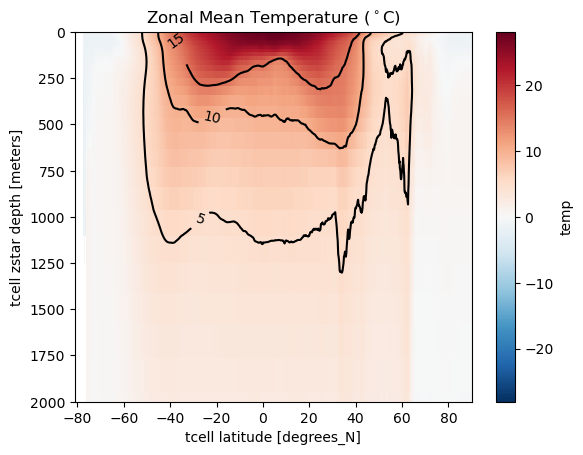

In [5]:
time = 0
fig, ax = plt.subplots()
(fmonth_mean.temp.where(fmonth_mean.temp>0).mean('xt_ocean')-273.15).plot()
CS = (fmonth_mean.temp.where(fmonth_mean.temp>0).mean('xt_ocean')-273.15).plot.contour(ax = ax, levels = [5,10,15],colors = 'k')
ax.clabel(CS, CS.levels, inline=True, fontsize=10)

plt.ylim(2000,0)
plt.title('Zonal Mean Temperature ($^\circ$C)')


In [11]:
fmonth_mean.temp.st_ocean.values[25]

677.1002526914099

In [14]:
fmonth_mean.temp.st_ocean.values[21]

368.65354740782504

## Plot slices to correlate v and T anomalies??

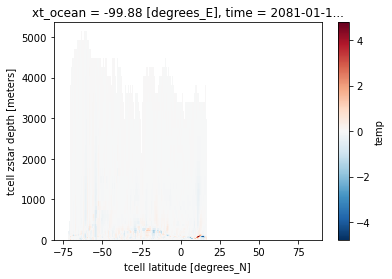

In [12]:
time = 0
(fmonth_m.temp.isel(time = time)-fmonth_sc.temp.isel(time = time)).sel(xt_ocean = -100, method = 'nearest').plot()

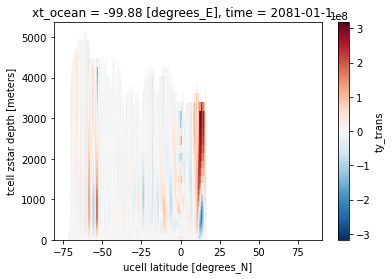

In [13]:
time = 0
(fmonth_m.ty_trans.isel(time = time)-fmonth_sc.ty_trans.isel(time = time)).sel(xt_ocean = -100, method = 'nearest').plot()

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.01/lib/python3.9/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.01/lib/python3.9/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.01/lib/python3.9/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.01/lib/python3.9/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.01/lib/python3.9/site-packages/dask/core.py:119: RuntimeWarning: invalid value encounte

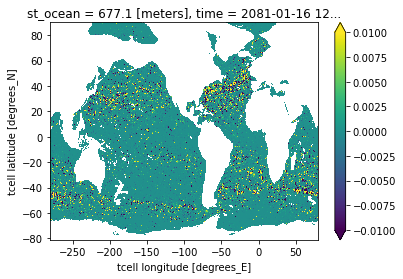

In [14]:
ty_anom = (fmonth_m.ty_trans.isel(time = time)-fmonth_sc.ty_trans.isel(time = time))/fmonth_sc.ty_trans.isel(time = time)
temp_anom = (fmonth_m.temp.isel(time = time)-fmonth_sc.temp.isel(time = time))/(fmonth_sc.temp.isel(time = time))

ty_anom = gridmn.interp(ty_anom,'y',boundary = 'extend')
(ty_anom*temp_anom).isel(st_ocean = 25).plot(vmax = 0.01, vmin = -0.01)

In [15]:
fmonth_m

,Array,Chunk
Bytes,34.76 GiB,759.38 kiB
Shape,"(120, 50, 1080, 1440)","(1, 50, 54, 72)"
Count,96250 Tasks,48000 Chunks
Type,float32,numpy.ndarray
,Array,Chunk
Bytes,34.76 GiB,759.38 kiB
Shape,"(120, 50, 1080, 1440)","(1, 50, 54, 72)"
Count,96250 Tasks,48000 Chunks
Type,float32,numpy.ndarray
,Array,Chunk


0
1
2
3
4
5
6
7
8
9


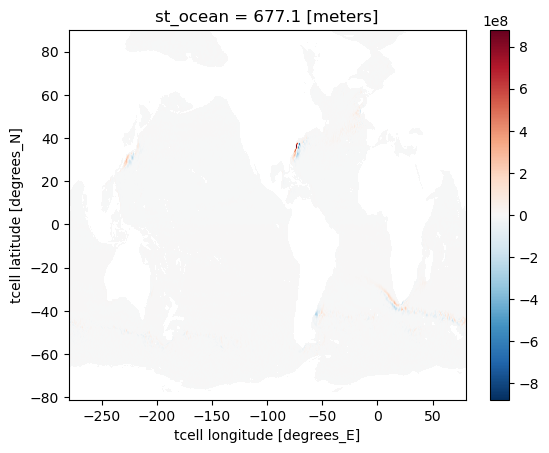

In [15]:
temp = 0
for i in np.arange(10):
    print(i)
    ty_anom = (fmonth_m.ty_trans.isel(time = np.arange(i*12,(i+1)*12)).values -fmonth_sc.ty_trans)#/fmonth_sc.ty_trans
    ty_anom = ty_anom.isel(st_ocean = 25)
    temp_anom = (fmonth_m.temp.isel(time = np.arange(i*12,(i+1)*12)).values-fmonth_sc.temp)#/(fmonth_sc.temp)
    temp_anom = temp_anom.isel(st_ocean = 25)

    ty_anom = gridmn.interp(ty_anom,'y',boundary = 'extend')
    temp1 = (ty_anom*temp_anom).mean('time')
    temp1.load()
    temp = temp+temp1
temp = temp/10
temp.plot()

Text(0.5, 1.0, '$\\overline{T^\\prime v^\\prime}$ at z = 677m')

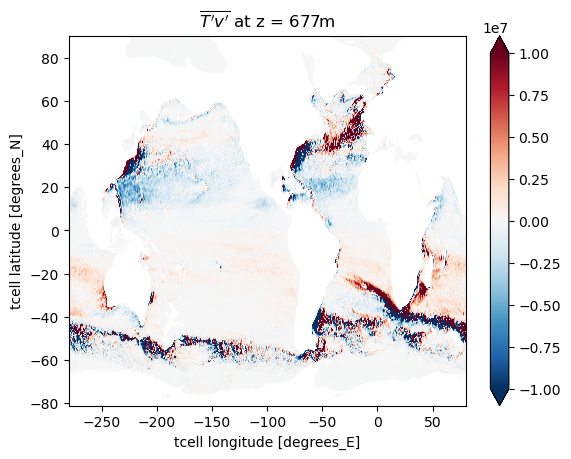

In [16]:
temp.plot(vmax = 1e7,vmin = -1e7,cmap = 'RdBu_r')
plt.title('$\overline{T^\prime v^\prime}$ at z = 677m')

Text(0.5, 1.0, 'Monthly anomaly from seasonal cycle of $\\overline{T^\\prime v^\\prime}$ at z = 677m')

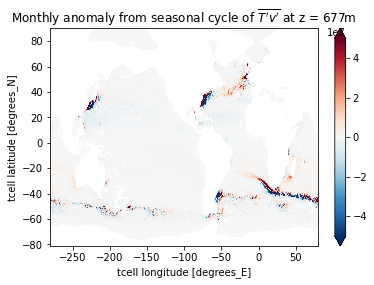

In [11]:
temp.plot(vmax = 5e7,vmin = -5e7,cmap = 'RdBu_r')
plt.title('Monthly anomaly from seasonal cycle of $\overline{T^\prime v^\prime}$ at z = 677m')

0
1
2
3
4
5
6
7
8
9
CPU times: user 7min 22s, sys: 2min 37s, total: 9min 59s
Wall time: 15min 24s


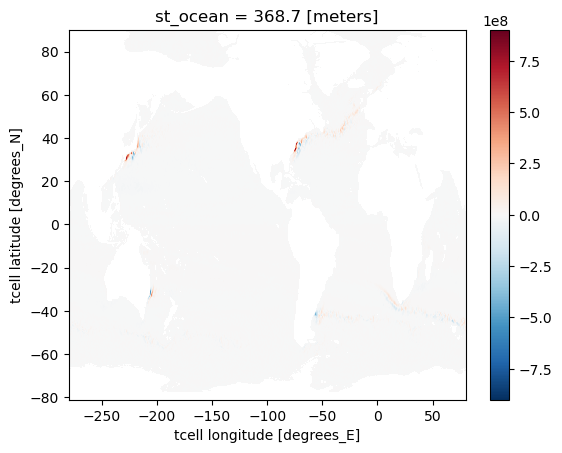

In [10]:
%%time
temp = 0
for i in np.arange(10):
    print(i)
    ty_anom = (fmonth_m.ty_trans.isel(time = np.arange(i*12,(i+1)*12)).values -fmonth_sc.ty_trans)#/fmonth_sc.ty_trans
    ty_anom = ty_anom.isel(st_ocean = 21)
    temp_anom = (fmonth_m.temp.isel(time = np.arange(i*12,(i+1)*12)).values-fmonth_sc.temp)#/(fmonth_sc.temp)
    temp_anom = temp_anom.isel(st_ocean = 21)

    ty_anom = gridmn.interp(ty_anom,'y',boundary = 'extend')
    temp1 = (ty_anom*temp_anom).mean('time')
    temp1.load()
    temp = temp+temp1
temp = temp/10
temp.plot()

Text(0.5, 1.0, 'Monthly anomaly from seasonal cycle of $\\overline{T^\\prime v^\\prime}$ at z = 369m')

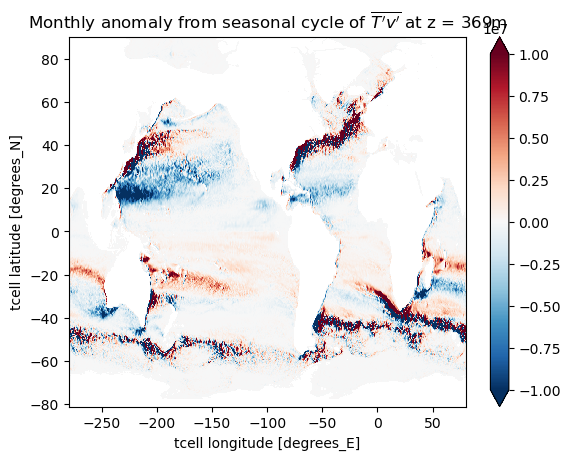

In [11]:
temp.plot(vmax = 1e7,vmin = -1e7,cmap = 'RdBu_r')
plt.title('Monthly anomaly from seasonal cycle of $\overline{T^\prime v^\prime}$ at z = 369m')

Text(0.5, 1.0, '$\\overline{T^\\prime v^\\prime}$ at z = 369m')

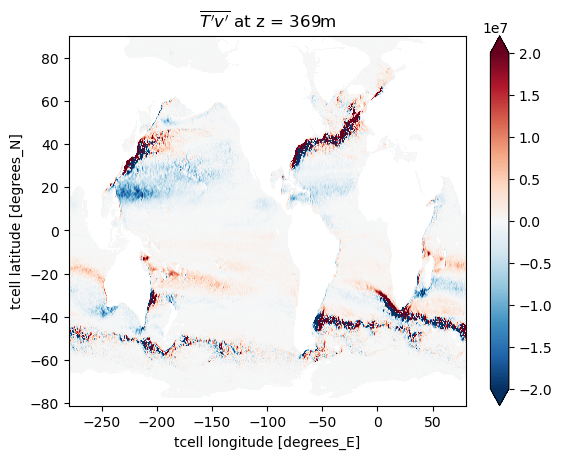

In [14]:
temp.plot(vmax = 2e7,vmin = -2e7,cmap = 'RdBu_r')
plt.title('$\overline{T^\prime v^\prime}$ at z = 369m')

## Plot slice of heat function

In [5]:
True_10year_means = xr.open_mfdataset('/g/data/e14/cy8964/Post_Process/temp/025deg_10yr_3d/True_10year_means.nc')#.chunk({'grid_yu_ocean':ych/10,'grid_yt_ocean':ych/10, 'grid_xt_ocean':xch/10})
Mean_10year_means = xr.open_mfdataset('/g/data/e14/cy8964/Post_Process/temp/025deg_10yr_3d/Mean_10year_means.nc')#.chunk({'grid_yu_ocean':ych/10,'grid_yt_ocean':ych/10, 'grid_xt_ocean':xch/10})
Twomo_mean_10year_means = xr.open_mfdataset('/g/data/e14/cy8964/Post_Process/temp/025deg_10yr_3d/2mo_mean_10year_means.nc')#.chunk({'grid_yu_ocean':ych/10,'grid_yt_ocean':ych/10, 'grid_xt_ocean':xch/10})
sc_Twomo_mean_10year_means = xr.open_mfdataset('/g/data/e14/cy8964/Post_Process/temp/025deg_10yr_3d/sc_2mo_mean_10year_means.nc')#.chunk({'grid_yu_ocean':ych/10,'grid_yt_ocean':ych/10, 'grid_xt_ocean':xch/10})
Tenday_mean_10year_means = xr.open_mfdataset('/g/data/e14/cy8964/Post_Process/temp/025deg_10yr_3d/10day_mean_10year_means.nc')#.chunk({'grid_yu_ocean':ych/10,'grid_yt_ocean':ych/10, 'grid_xt_ocean':xch/10})
Oneday_mean_10year_means = xr.open_mfdataset('/g/data/e14/cy8964/Post_Process/temp/025deg_10yr_3d/1day_mean_10year_means.nc')#.chunk({'grid_yu_ocean':ych/10,'grid_yt_ocean':ych/10,'grid_xt_ocean':xch/10})


In [6]:
Psi = True_10year_means.Psi
Psi_mean_tot = Mean_10year_means.Psi
Psi_ac = (sc_Twomo_mean_10year_means - Mean_10year_means).Psi
Psi_lt = (Twomo_mean_10year_means - sc_Twomo_mean_10year_means).Psi

Psi_TIWs = (Tenday_mean_10year_means - Twomo_mean_10year_means).Psi
Psi_storm = (Oneday_mean_10year_means- Tenday_mean_10year_means).Psi
Psi_diurnal = (True_10year_means-Oneday_mean_10year_means).Psi

In [7]:
Hf = -Cp*rho0*dT*gridwm.cumsum(True_10year_means.Psi,'T',boundary="fill", fill_value=0)
Hf_mean_tot = -Cp*rho0*dT*gridwm.cumsum(Mean_10year_means.Psi,'T',boundary="fill", fill_value=0)
Hf_ac = -Cp*rho0*dT*gridwm.cumsum((sc_Twomo_mean_10year_means - Mean_10year_means).Psi,'T',boundary="fill", fill_value=0)
Hf_lt = -Cp*rho0*dT*gridwm.cumsum((Twomo_mean_10year_means - sc_Twomo_mean_10year_means).Psi,'T',boundary="fill", fill_value=0)

Hf_TIWs = -Cp*rho0*dT*gridwm.cumsum((Tenday_mean_10year_means - Twomo_mean_10year_means).Psi,'T',boundary="fill", fill_value=0)
Hf_storm = -Cp*rho0*dT*gridwm.cumsum((Oneday_mean_10year_means- Tenday_mean_10year_means).Psi,'T',boundary="fill", fill_value=0)
Hf_diurnal = -Cp*rho0*dT*gridwm.cumsum((True_10year_means-Oneday_mean_10year_means).Psi,'T',boundary="fill", fill_value=0)


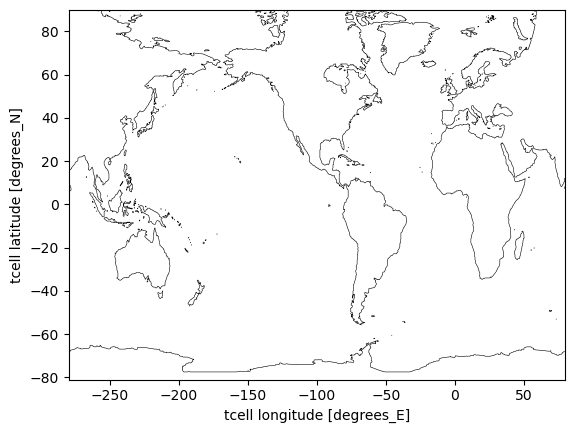

In [8]:
mask = (fgrd.ht.where(fgrd.ht>0)*0+1).fillna(0)
mask.plot.contour(levels = [0.5],linewidths = 0.4, colors = 'k')

Text(0.5, 1.0, 'Heat function slice at 10$^\\circ$C')

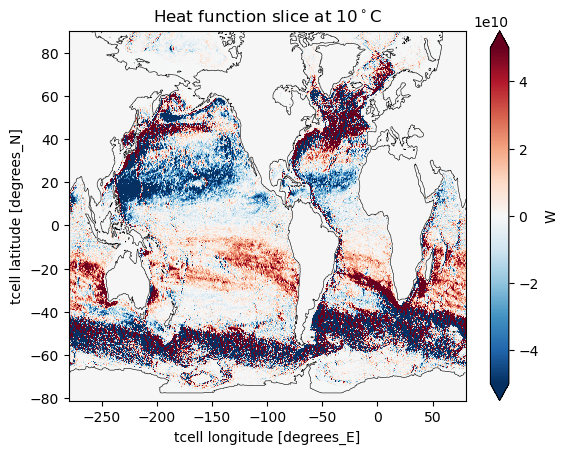

In [9]:
Hf_lt.sel(neutral = 10,method = 'nearest').plot(vmin = -5e10,vmax = 5e10, cmap = 'RdBu_r',cbar_kwargs={'label':'W'})
mask.plot.contour(levels = [0.5],linewidths = 0.4, colors = 'k')
plt.title('Heat function slice at 10$^\circ$C')

Text(0.5, 1.0, 'Heat function slice at 15$^\\circ$C')

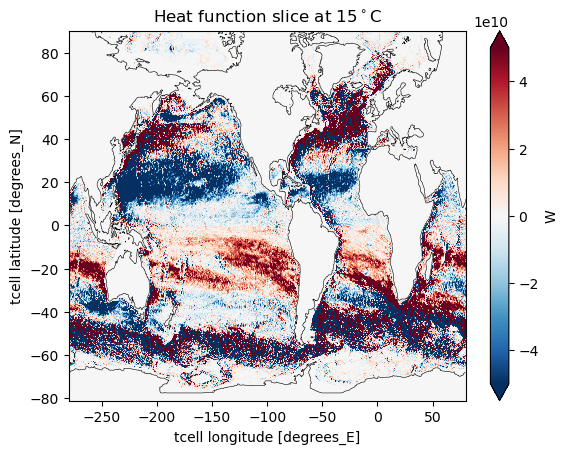

In [11]:
Hf_lt.sel(neutral = 15,method = 'nearest').plot(vmin = -5e10,vmax = 5e10, cmap = 'RdBu_r',cbar_kwargs={'label':'W'})
mask.plot.contour(levels = [0.5],linewidths = 0.4, colors = 'k')
plt.title('Heat function slice at 15$^\circ$C')

## Snapshot

0


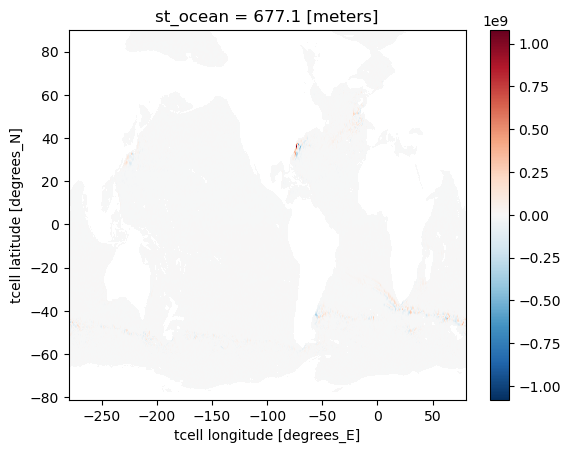

In [12]:
# do for 1 year instead of 10 - less smoothing

temp = 0
for i in np.arange(1):
    print(i)
    ty_anom = (fmonth_m.ty_trans.isel(time = np.arange(i*12,(i+1)*12)).values -fmonth_sc.ty_trans)#/fmonth_sc.ty_trans
    ty_anom = ty_anom.isel(st_ocean = 25)
    temp_anom = (fmonth_m.temp.isel(time = np.arange(i*12,(i+1)*12)).values-fmonth_sc.temp)#/(fmonth_sc.temp)
    temp_anom = temp_anom.isel(st_ocean = 25)

    ty_anom = gridmn.interp(ty_anom,'y',boundary = 'extend')
    temp1 = (ty_anom*temp_anom).mean('time')
    temp1.load()
    temp = temp+temp1
temp = temp/1
temp.plot()

Text(0.5, 1.0, '$\\overline{T^\\prime v^\\prime}$ at z = 677m, year 1')

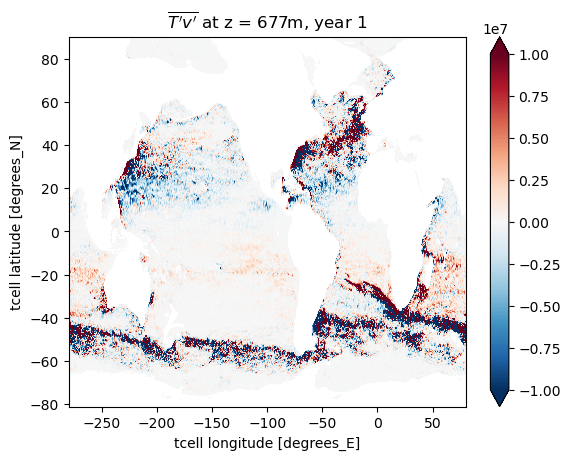

In [13]:
temp.plot(vmax = 1e7,vmin = -1e7,cmap = 'RdBu_r')
plt.title('$\overline{T^\prime v^\prime}$ at z = 677m, year 1')

0


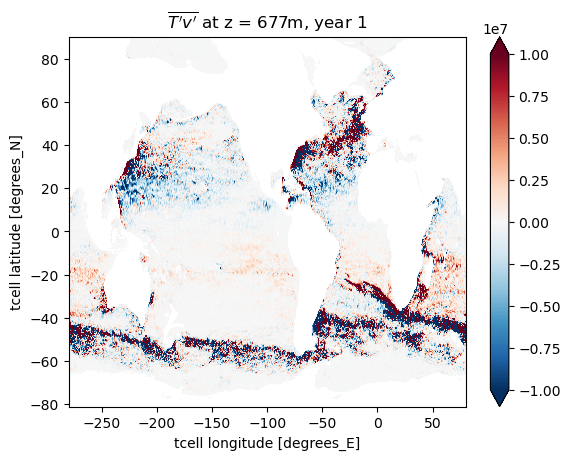

1


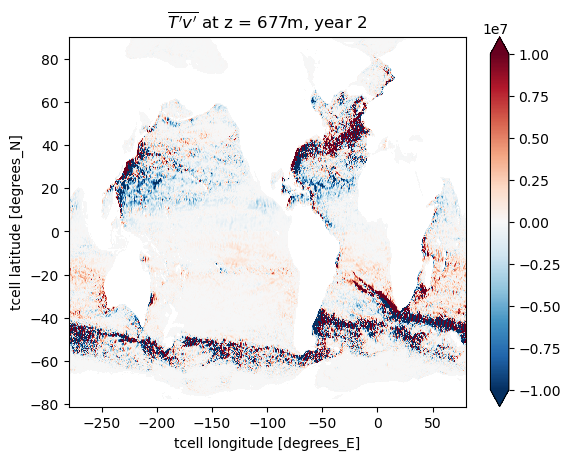

2


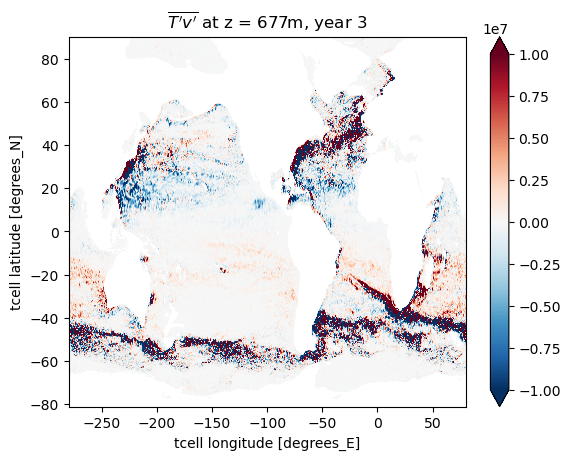

3


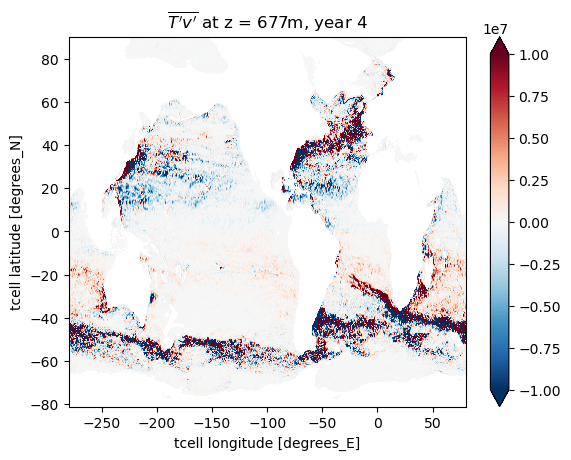

4


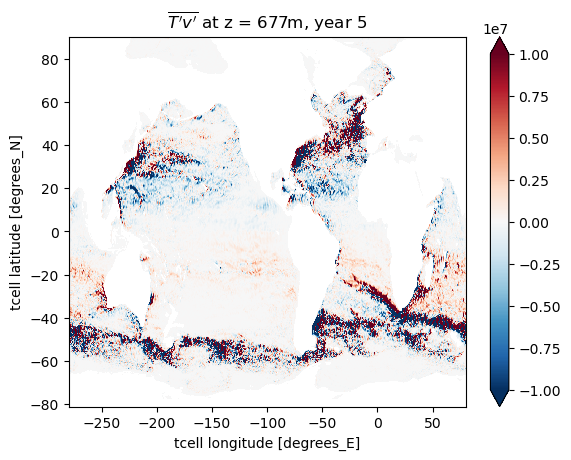

5


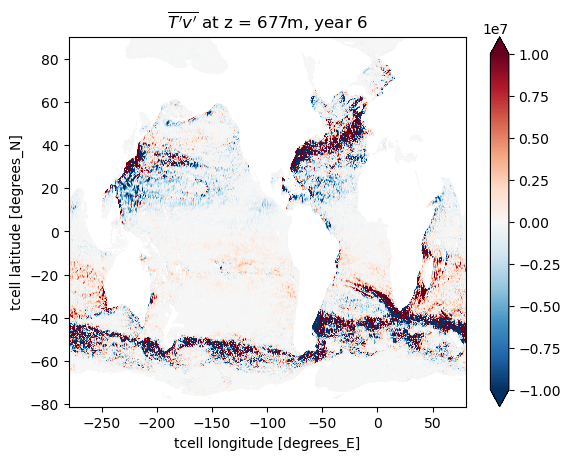

6


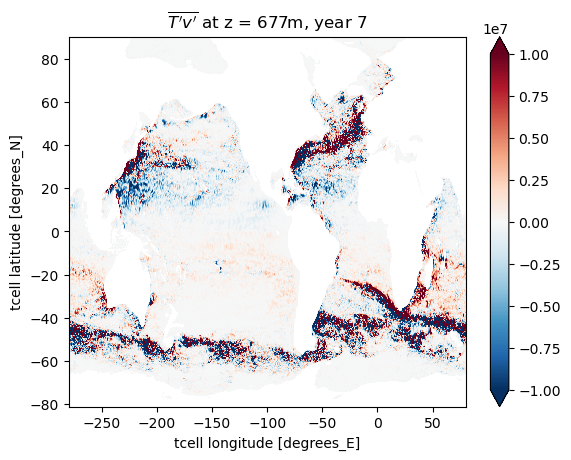

7


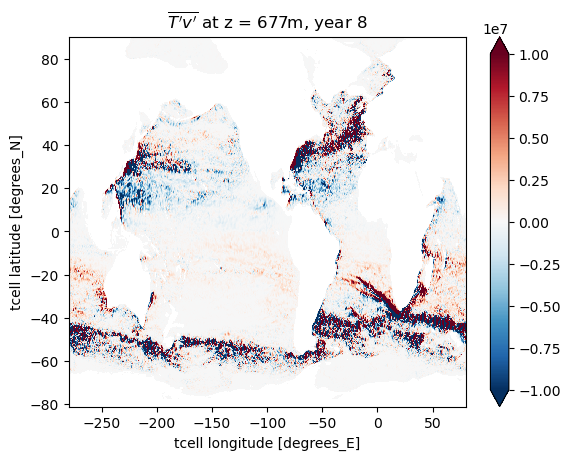

8


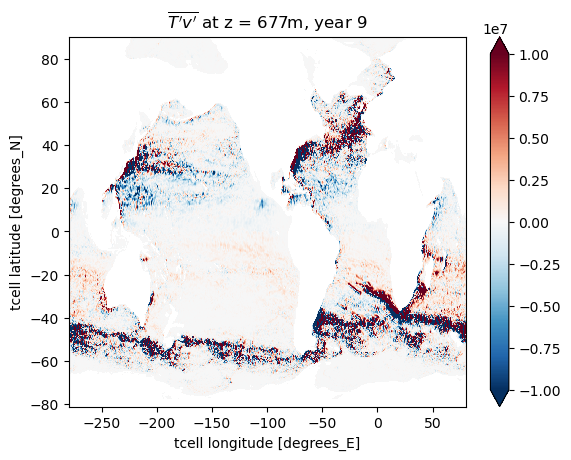

9


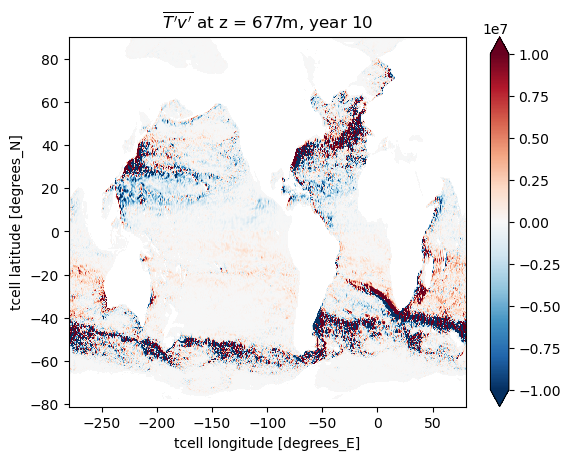

In [5]:
# do for 1 year instead of 10 - less smoothing

temp = 0
for i in np.arange(10):
    print(i)
    ty_anom = (fmonth_m.ty_trans.isel(time = np.arange(i*12,(i+1)*12)).values -fmonth_sc.ty_trans)#/fmonth_sc.ty_trans
    ty_anom = ty_anom.isel(st_ocean = 25)
    temp_anom = (fmonth_m.temp.isel(time = np.arange(i*12,(i+1)*12)).values-fmonth_sc.temp)#/(fmonth_sc.temp)
    temp_anom = temp_anom.isel(st_ocean = 25)

    ty_anom = gridmn.interp(ty_anom,'y',boundary = 'extend')
    temp1 = (ty_anom*temp_anom).mean('time')
    temp1.load()
    temp1.plot(vmax = 1e7,vmin = -1e7,cmap = 'RdBu_r')
    plt.title('$\overline{T^\prime v^\prime}$ at z = 677m, year '+str(i+1))
    plt.show()

0


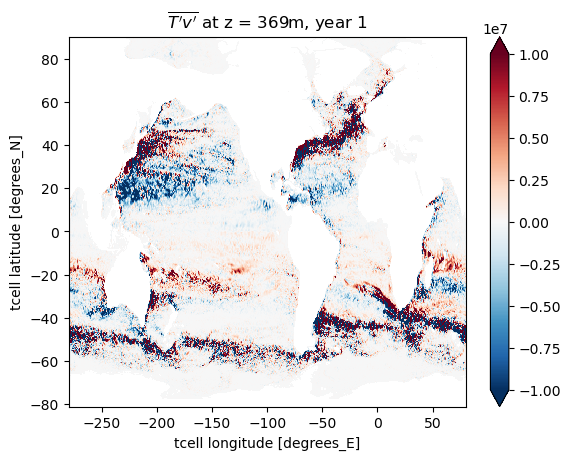

1


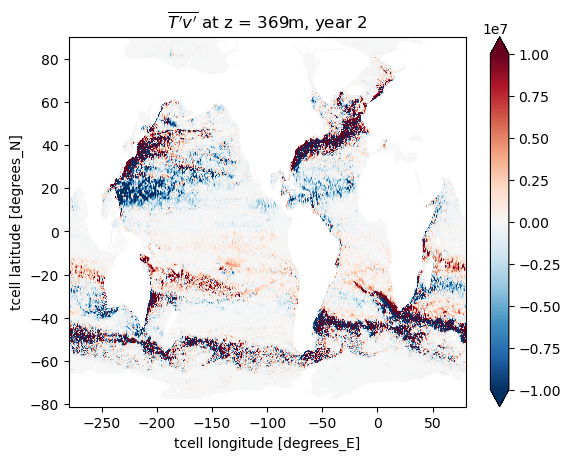

2


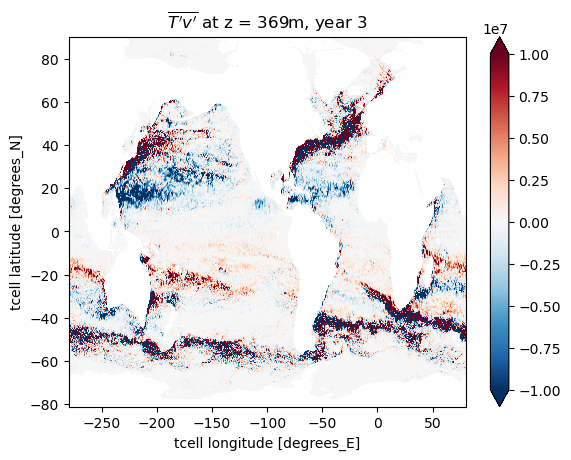

3


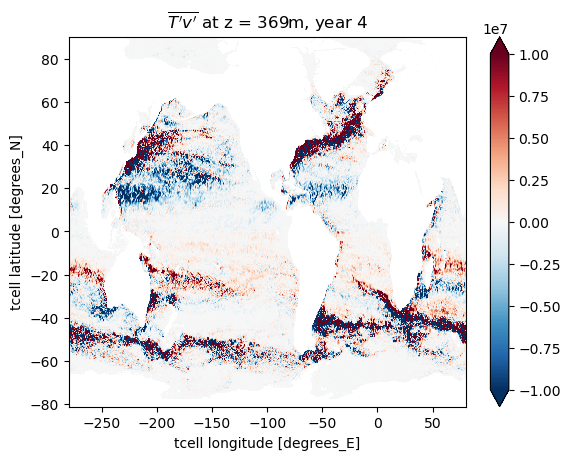

4


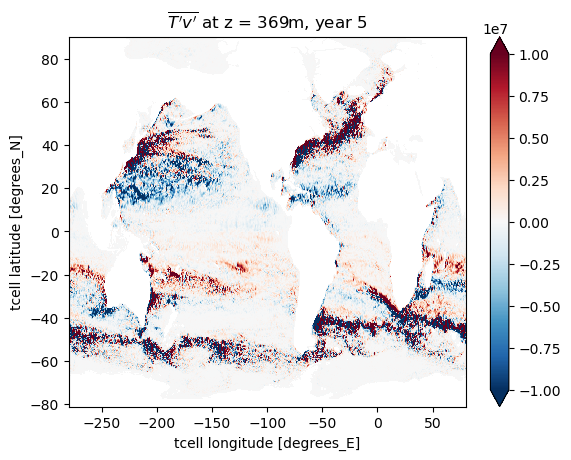

5


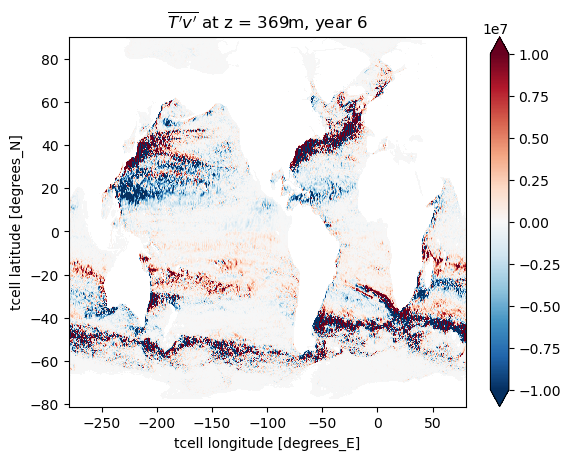

6


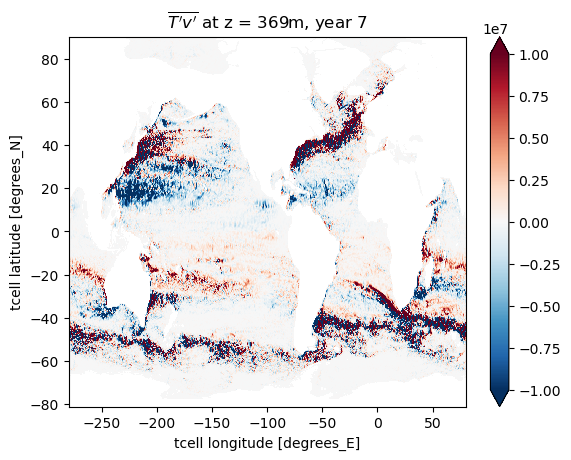

7


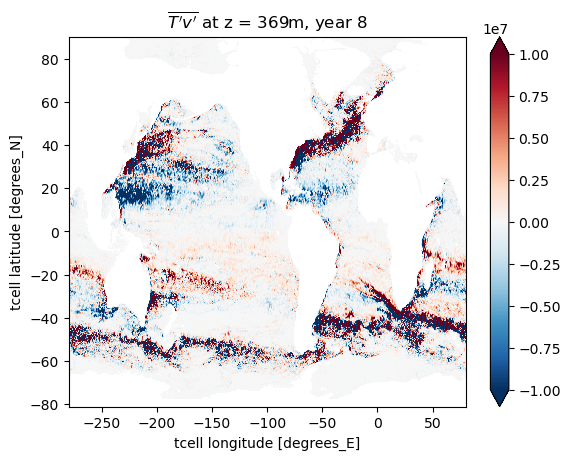

8


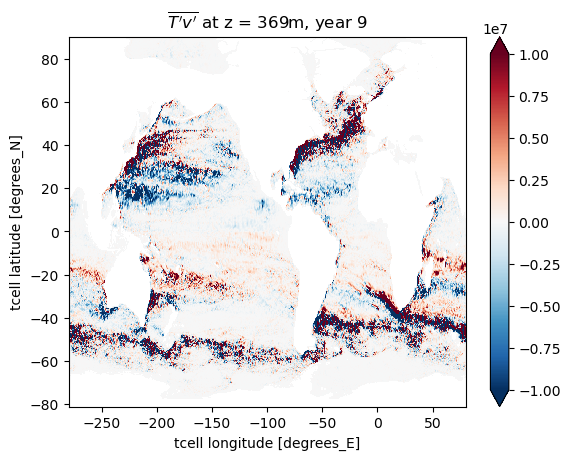

9


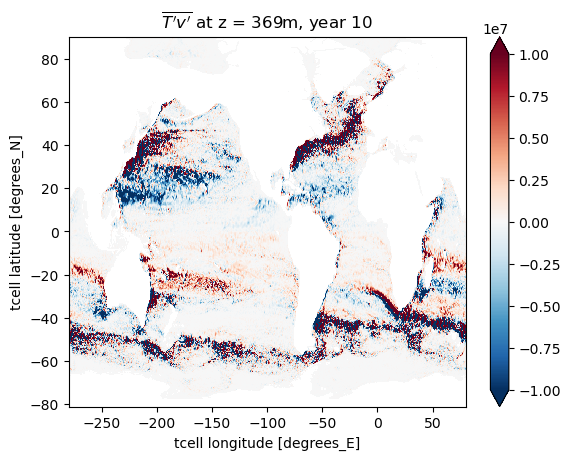

In [11]:
# do for 1 year instead of 10 - less smoothing

temp = 0
for i in np.arange(10):
    print(i)
    ty_anom = (fmonth_m.ty_trans.isel(time = np.arange(i*12,(i+1)*12)).values -fmonth_sc.ty_trans)#/fmonth_sc.ty_trans
    ty_anom = ty_anom.isel(st_ocean = 21)
    temp_anom = (fmonth_m.temp.isel(time = np.arange(i*12,(i+1)*12)).values-fmonth_sc.temp)#/(fmonth_sc.temp)
    temp_anom = temp_anom.isel(st_ocean = 21)

    ty_anom = gridmn.interp(ty_anom,'y',boundary = 'extend')
    temp1 = (ty_anom*temp_anom).mean('time')
    temp1.load()
    temp1.plot(vmax = 1e7,vmin = -1e7,cmap = 'RdBu_r')
    plt.title('$\overline{T^\prime v^\prime}$ at z = 369m, year '+str(i+1))
    plt.show()

Task exception was never retrieved
future: <Task finished name='Task-986908' coro=<Client._gather.<locals>.wait() done, defined at /g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/distributed/client.py:2122> exception=AllExit()>
Traceback (most recent call last):
  File "/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/distributed/client.py", line 2131, in wait
    raise AllExit()
distributed.client.AllExit


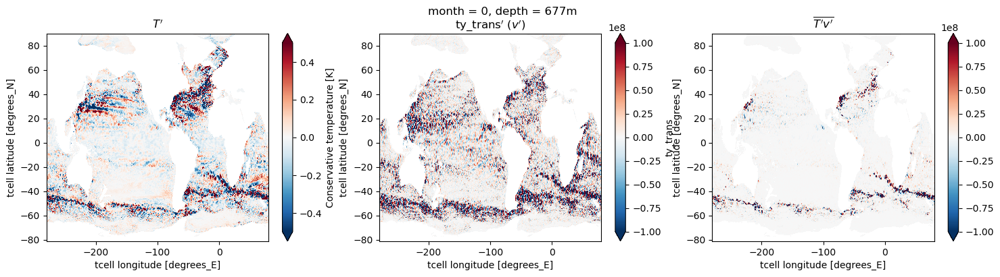

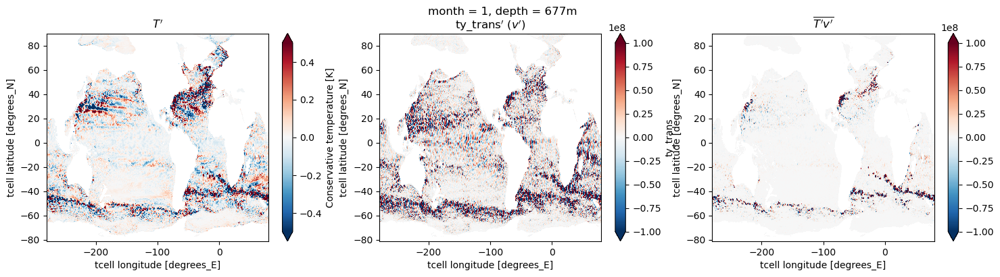

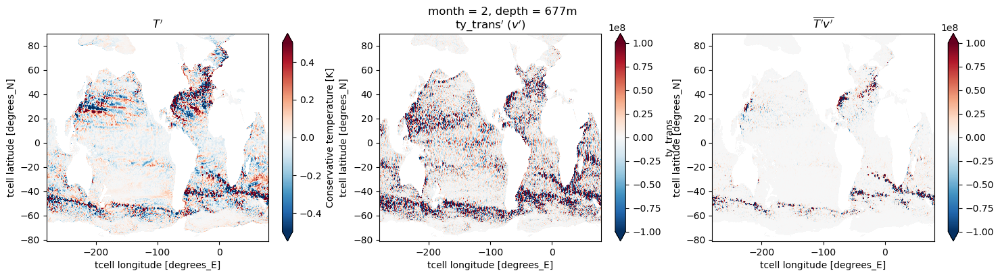

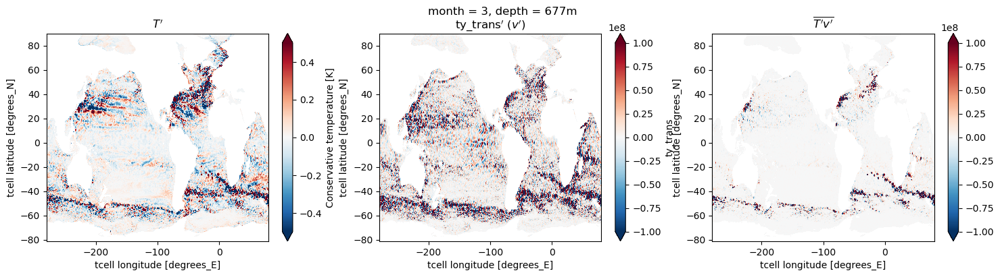

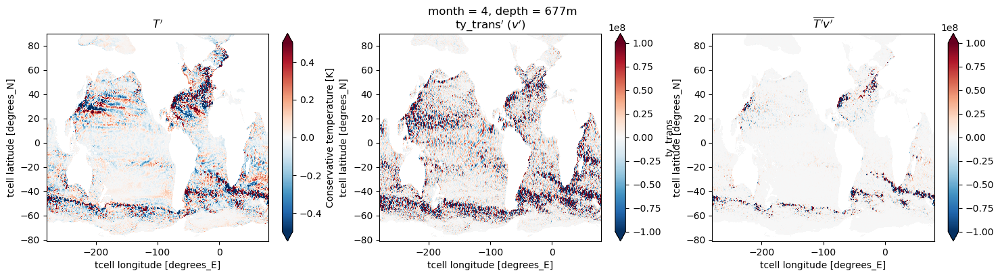

...

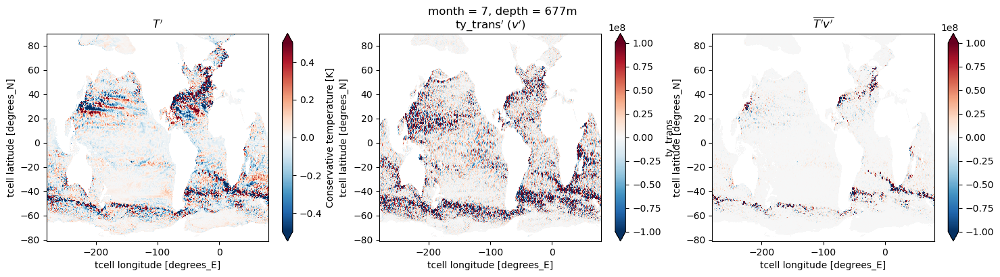

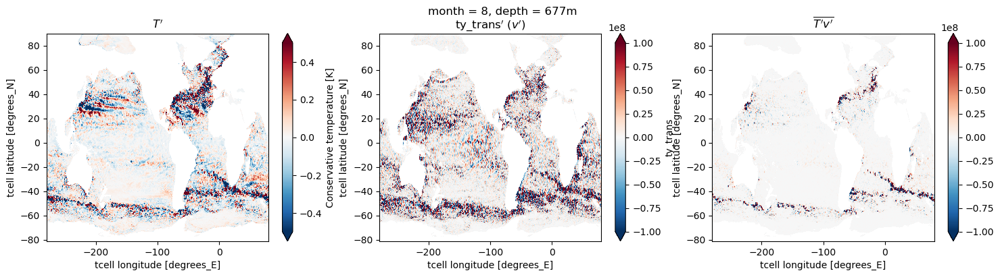

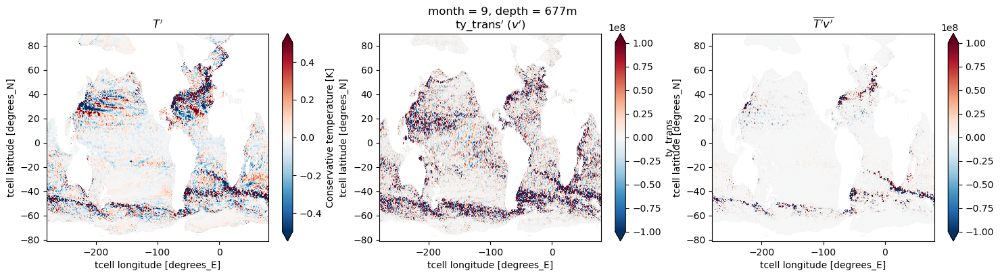

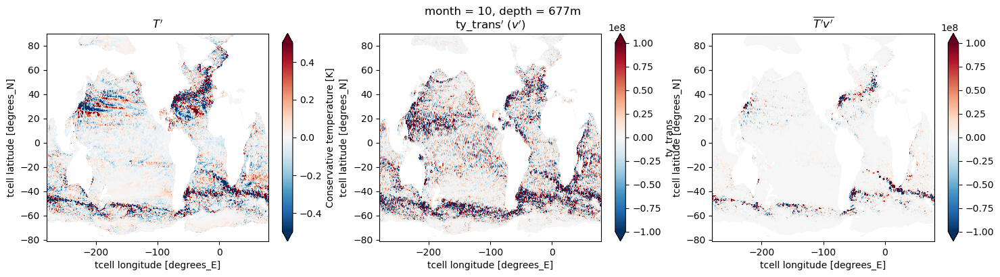

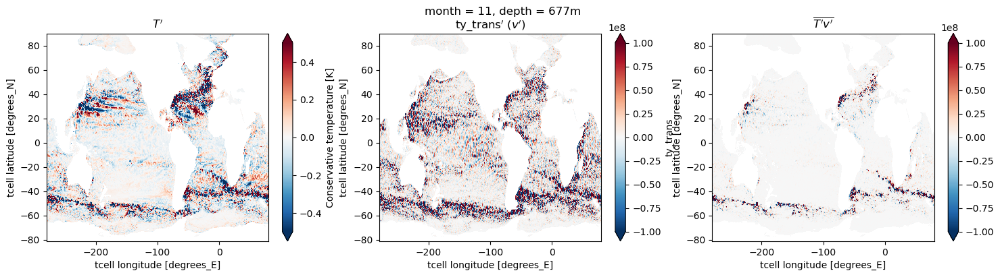

In [9]:
# snapshot of T' and v'
i = 0 #year 1
ty_anom = (fmonth_m.ty_trans.isel(time = np.arange(i*12,(i+1)*12)).values -fmonth_sc.ty_trans)#/fmonth_sc.ty_trans
ty_anom = ty_anom.isel(st_ocean = 25)
temp_anom = (fmonth_m.temp.isel(time = np.arange(i*12,(i+1)*12)).values-fmonth_sc.temp)#/(fmonth_sc.temp)
temp_anom = temp_anom.isel(st_ocean = 25)
ty_anom = gridmn.interp(ty_anom,'y',boundary = 'extend')

for j in np.arange(12):
    fig, axes = plt.subplots(figsize = (18,4), ncols = 3)
    temp_anom.isel(time = j).plot(ax = axes[0], vmax = 0.5, vmin = -0.5,cmap = 'RdBu_r')    
    ty_anom.isel(time = j).plot(ax = axes[1], vmax = 1e8, vmin = -1e8,cmap = 'RdBu_r')

    temp1 = (ty_anom.isel(time = j)*temp_anom.isel(time = j))
    temp1.load()
    temp1.plot(ax = axes[2],vmax = 1e8,vmin = -1e8,cmap = 'RdBu_r')
    
    axes[1].set_title('ty_trans$^\prime$ ($v^\prime$)')
    axes[0].set_title('$T^\prime$')
    axes[2].set_title('$\overline{T^\prime v^\prime}$')
    
    plt.suptitle('month = '+str(j)+', depth = 677m')
    plt.show()

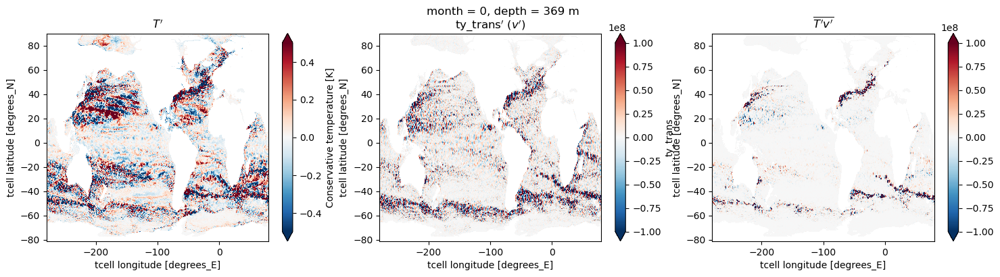

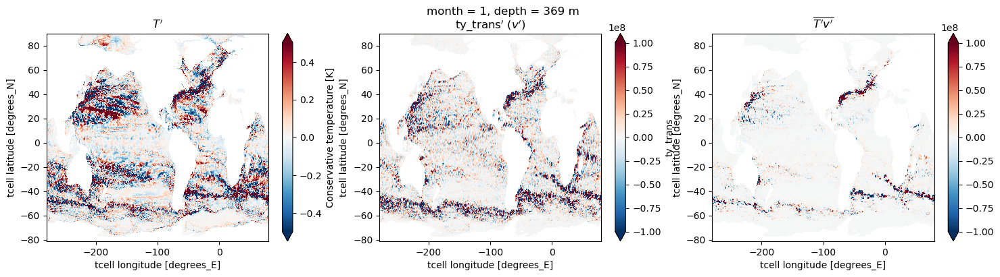

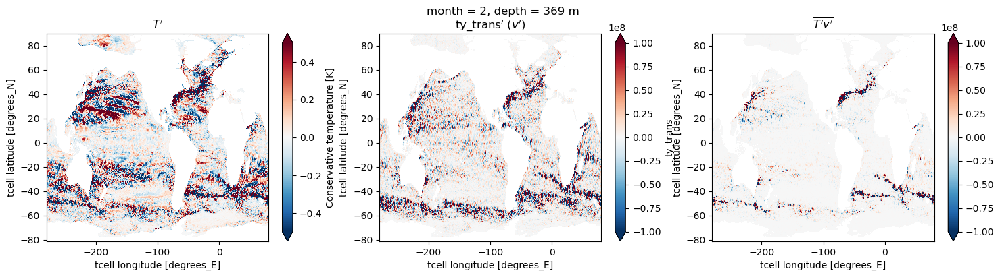

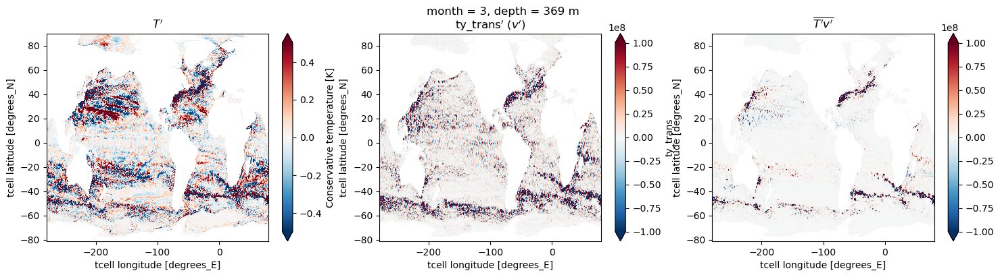

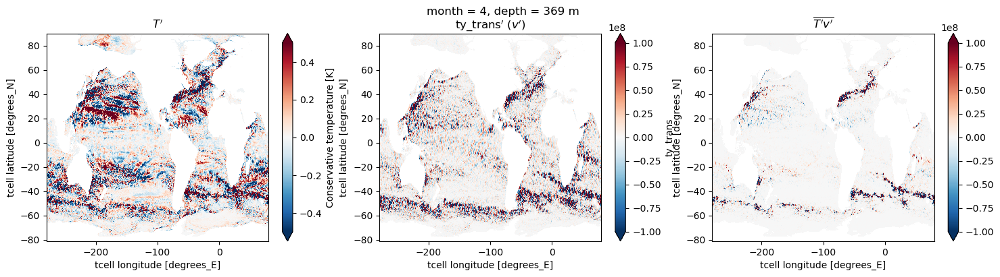

...

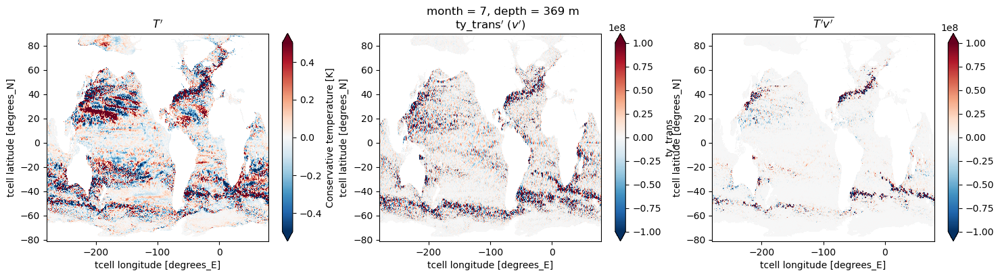

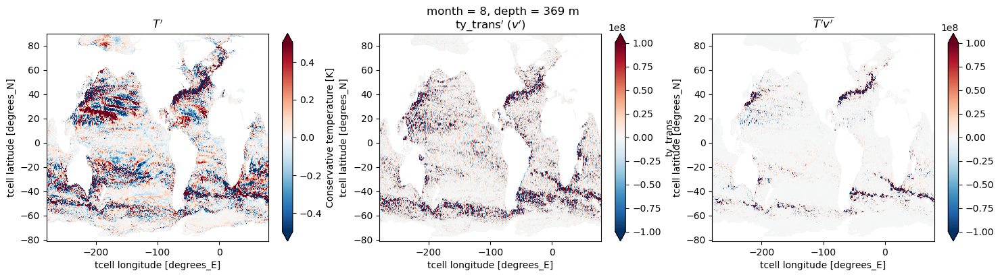

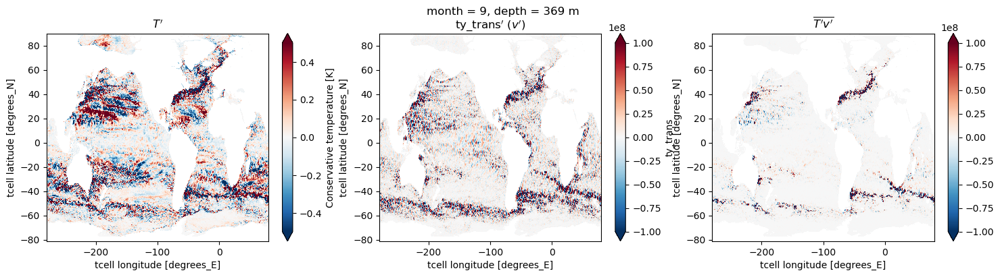

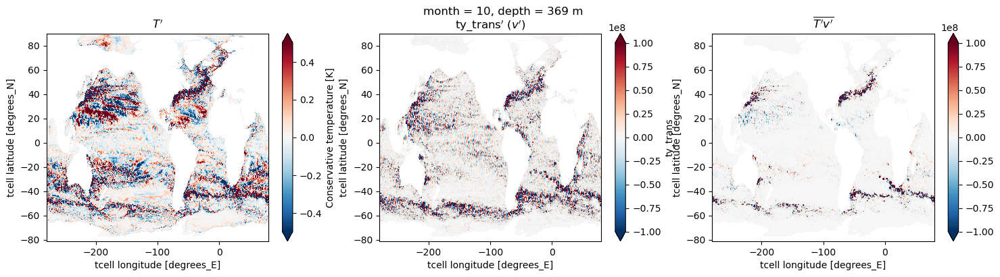

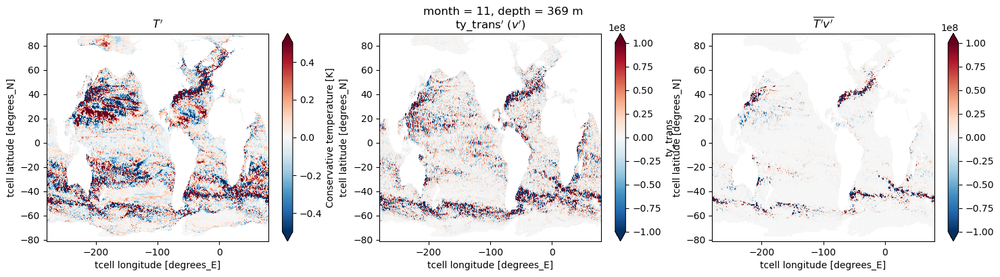

In [10]:
# snapshot of T' and v'
i = 0 #year 1
ty_anom = (fmonth_m.ty_trans.isel(time = np.arange(i*12,(i+1)*12)).values -fmonth_sc.ty_trans)#/fmonth_sc.ty_trans
ty_anom = ty_anom.isel(st_ocean = 21)
temp_anom = (fmonth_m.temp.isel(time = np.arange(i*12,(i+1)*12)).values-fmonth_sc.temp)#/(fmonth_sc.temp)
temp_anom = temp_anom.isel(st_ocean = 21)
ty_anom = gridmn.interp(ty_anom,'y',boundary = 'extend')

for j in np.arange(12):
    fig, axes = plt.subplots(figsize = (18,4), ncols = 3)
    temp_anom.isel(time = j).plot(ax = axes[0], vmax = 0.5, vmin = -0.5,cmap = 'RdBu_r')    
    ty_anom.isel(time = j).plot(ax = axes[1], vmax = 1e8, vmin = -1e8,cmap = 'RdBu_r')

    temp1 = (ty_anom.isel(time = j)*temp_anom.isel(time = j))
    temp1.load()
    temp1.plot(ax = axes[2],vmax = 1e8,vmin = -1e8,cmap = 'RdBu_r')
    
    axes[1].set_title('ty_trans$^\prime$ ($v^\prime$)')
    axes[0].set_title('$T^\prime$')
    axes[2].set_title('$\overline{T^\prime v^\prime}$')
    
    plt.suptitle('month = '+str(j)+', depth = 369 m')
    plt.show()